<font color='cornflowerblue' size=5>**Making Orbital Dreams Come True**</font>

We'll be using a Python package called **Rebound** which calculates orbits for planetary systems.

The package solves the equations of motion (positions, velocities, and accelerations) for a planet under the influence of a star's gravitational pull.  We can explicity write down the solution for the orbit of *one* body around another, but the solution for a system with three or more objects cannot be written down. At this point, we have to turn to software packages to solve the gravitational interactions that other planets have on each other numerically.

If you want more information about Rebound, you can always look at the source code and the documentation.

https://github.com/hannorein/rebound

http://rebound.readthedocs.org

We first need to import the package that will create our orbital simulations, *Rebound*, as well as *numpy*, so we can do math, and *matplotlib* so we can make plots!

In [1]:
#################################################################
# import some packages that will make programming easier for us #
#################################################################
import rebound
import numpy as np
from numpy import *
import matplotlib.pyplot as plt
%matplotlib inline  

#################################################################
# in order to use other notebooks in this folder,               #
# we have to let python know where to look in our google drive  #
#################################################################

%run tools.ipynb 
# Some behind-the-scenes tools to simplify some complicated code


Next, we need to initialize our simulation.

In [2]:
# This tells the rebound package that we want to start a simulation. This simulation is called 'sim'!
sim = rebound.Simulation()

When we talk about the masses of stars, timescales, etc., we have to specify the unit that we are listing these values in. 

Astronomers typically use solar masses, or $\textrm{M}_\odot$. For a star that has 2 times as much mass as our Sun, we say it has a mass of $2\textrm{M}_\odot$. If a star is half as massive as our Sun, it has a mass of $0.5\textrm{M}_\odot$. Similarly, the year is defined by how long it takes for the Earth to complete one revolution around the Sun. An astronomical unit (AU) is the distance between the Earth and the Sun. These are the natural units for our own Solar System, and we tend to talk about all other planetary systems in these same units.


To make things easier for ourselves, let's tell the simulation to use the same units we're familiar with! 

In all astronomical simulations, the units of the system are scaled relative to the gravitational constant $G$, which is used when calculating gravitational forces. By defining the value for $G$, we define many of the units for all other parameters in the simulation. In our Solar System units, the value of $G=4\pi^{2}$ $\textrm{AU}^{3}$ $\textrm{M}_{\odot}^{-1}$ yr$^{-2}$. For reference, $4 \pi^2 \approx 39.5$.

In [3]:
# Fill in the right value of G for solar masses, AU, and years
sim.G = 4.*np.pi**2.

# We'll also set the correct units for our simulation
sim.units = ('yr', 'AU', 'Msun')

Now, let's add a star to our simulation. <font color='red'>**Make sure that your star is always the first thing you add to a simulation!**</font>

In [4]:
# m = is where you write the mass of the star in solar masses, and 'hash' allows us to give a name to our star!
sim.add(m=1., hash='Sun')  # This adds a 1 solar mass star at the center of our simulation named 'Sun'.

We can now add a planet.  Let's add a planet with the same mass as at the distance of the Earth (1 AU).  Remember that we need to convert all of our units to years, AU, and solar masses - including our planets, even though they are much less massive than the Sun. If you Google the mass of Jupiter, you're likely to find a number like 317 Earth masses. A useful conversion to remember is $1 \textrm{ M}_{\odot} \approx 333,000 \textrm{ M}_{\textrm{Earth}}$:

$$\frac{\textrm{Jupiter}}{\textrm{Sun}}=\frac{317 \textrm{ Earth masses}}{333,000\textrm{ Earth masses}}\approx\frac{1}{1000}=1\textrm{e}{-3}$$

To make things a little easier in the future, I'm going to give you all the masses of each planet (and also the dwarf planet Pluto just for fun)! 

In [5]:
# masses are all going to be in kg. In order to get masses in solar masses, 
# just divide each one by the mass of the sun!

mass_Sun     = 1.989e30
mass_Mercury = 3.285e23
mass_Venus   = 4.867e24 # similar to the mass of the earth!
mass_Earth   = 5.972e24
mass_Mars    = 6.390e23
mass_Jupiter = 1.898e27
mass_Saturn  = 5.683e26
mass_Uranus  = 8.681e25
mass_Neptune = 1.024e26
mass_Pluto   = 1.309e22 # not a planet, but still fun to plot!

# here, the mass of Jupiter in solar masses is mass_Jupiter/mass_Sun.

We also need to fill in the distance of each planet from the Sun! This link might be helpful: 
http://hyperphysics.phy-astr.gsu.edu/hbase/Solar/soldata.html#c1 

You might find this link useful for a lot of what we do for this research project.

Try to recall what $a$ means!

In [6]:
# the following distances are all in AU!
a_Mercury = 0.387
a_Venus   = 0.723
a_Earth   = 1
a_Mars    = 1.523
a_Jupiter = 5.205
a_Saturn  = 9.582
a_Uranus  = 19.2
a_Neptune = 30.05
a_Pluto   = 39.48


Recall from yesterday that there are 6 unique parameters that are needed to define an orbit: semi-major axis (a), eccentricity (e), inclination (inc or $i$), argument of pericenter (omega or $\omega$), longitude of the ascending node (Omega or $\Omega$), and true anomaly (f). To add a planet to your simulation, all of these parameters and the planet mass must be defined. However, *if you don't give a value for a parameter to Rebound, it will be set to be 0.* We can define the orbital elements of our planet using: m (for mass), a (for semi-major Axis), e (eccentricity), inc (inclination), omega (argument of periapsis), Omega (longitude of ascending node), and f (true anomaly).  


In [7]:
# Remember that inc, omega, Omega, and f have to be in radians!
# Here is the template for adding a planet:
# sim.add(m = mass, a = semi-major axis, e = eccentricity, inc = inclination, omega = a of periapsis, Omega = l of Ascending Node, f = True Anomaly, hash='Planet Name')

# We'll add Jupiter, and ignore all the parameters except the mass and distance:
sim.add(m=mass_Jupiter/mass_Sun, a=1, hash='Planet') 

# Because we've added more than 1 body to our simulation, we need to reset the center
# of the simulation before we can run it.
sim.move_to_com()


Let's now make a plot of this planet and its orbit.  Rebound has a very nice function that we can call that will plot things for us automatically.

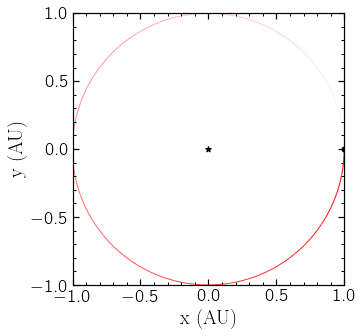

In [8]:
fig,ax = rebound.OrbitPlot(sim, unitlabel="(AU)", color=True)
ax.set_xlim(-1,1)
ax.set_ylim(-1,1)
plt.show()

Now, let's evolve the orbit of our planet forward in time.



Rebound plotted the position and previous orbit of the planet that we added. But what if we want to see where I'll planet will go in the future? 

The Rebound simulation stores the time in the variable ```sim.t```. We can check what the time is at any point by printing out the value of this variable. To evolve our orbit forward in time, we use the Rebound function ```sim.integrate``` which will evolve our system in time from 0 years up to the time we specify.

In [9]:
# We can find the current time in the simulation by looking at sim.t
print(sim.t)


0.0


Let's evolve our system for half of a year. We want to see how the system will evolve from t = 0 to t = t$_{\rm end}$, the end time. What time will we put in the function below? 

In [10]:
# this cell will not run correctly unless we change t_end

sim.integrate(0.5) # this is the function that evolves the system from t = 0 to t = t_end.

# Now, let's see what our simulation says the new time is.
print(sim.t)

0.5


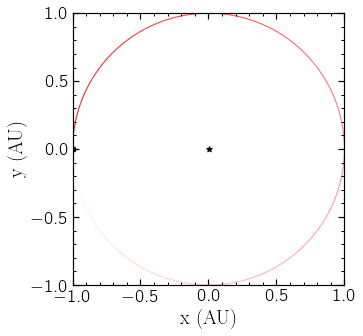

In [11]:
# As an important note, we've now forever modified the simulation. 
# What this means, is that we've evolved the system, so if we try 
# to make the same plot from above, we will see that the system have changed!

# If you want to restart the entire simulation to this point, 
# use the menu up top to do *Runtime* > *Run Above* and then re-run this cell.

fig, ax = rebound.OrbitPlot(sim, unitlabel="(AU)", color=True)
ax.set_xlim(-1,1)
ax.set_ylim(-1,1)
plt.show()

We can see that the planet has moved forward by half an orbit! <font color='cornflowerblue'>**Why does 1/2 of a year correspond to half of an orbit in this simulation?**</font> 

*Hint: we mentioned something about this yesterday!*
<br/><br/>
<br/><br/>
<br/><br/>
<br/><br/>

Let's see what happens if we run the simulation for 100 years!! 

100.0


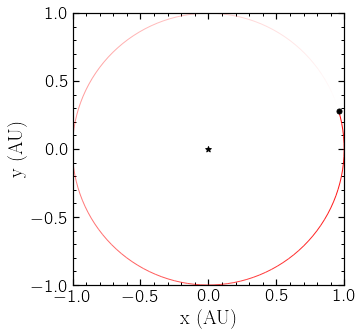

In [12]:
# We can run our simulation for even longer.
# The longer you integrate, the longer the code will take to run.
sim.integrate(100) # integrate to a end time of 100 years
print(sim.t)


fig,ax = rebound.OrbitPlot(sim, unitlabel="(AU)", color=True)
ax.set_xlim(-1,1)
ax.set_ylim(-1,1)
plt.show()
#plt.savefig('test.png')

Hmm... so we started with the planet on the very right part of the diagram. And we went forward exactly 100 years. Why is our planet not on the very right side of the diagram like the first one we made? 

In [13]:
orbits = sim.calculate_orbits() # Calculate all planet orbits at the simulation's current time

for orbit in orbits: # This for loop will print out the orbit of each planet in your simulation
    print(orbit)

<rebound.Orbit instance, a=1.0000000000000004 e=1.5265467532569565e-15 inc=0.0 Omega=0.0 omega=1.620815380252383 f=-1.332973127765021>


While $a$ is very close to 1, and most of the rest of the numbers are close to 0, they are not exactly 0.  In any system where there is more than one body with mass (i.e., any planetary system), the orbits **will** change, even if it is a small, non-catastrophic change. In this case, what we're seeing is called *orbital precession*, or a predictable change over time in the orbit.


<font color='cornflowerblue'>**Let's explore how different parameters change the orbit!**</font> 
<br/><br/>
<br/><br/>


In [14]:
# here, we will start a new simulation, add our Sun, 
# then add a couple planets, changing one parameter 
# at a time and seeing how the orbits change:

# here is an example of adding a planet with all of the parameters we've talked about.
# sim.add(m = mass, a = semi-major axis, e = eccentricity, inc = inclination, omega = a of periapsis, Omega = l of Ascending Node, f = True Anomaly, hash='Planet Name')

# how do we start a new simulation and add a star?


<br/><br/>
<br/><br/>

Now, let's set up a new simulation to explore some other things we can do.  To make things easier, I'm going to create a Python _definition_, or a user-written function that we can call.  The definition has to be defined before you try to use it.  With this definition, we don't have to re-type all the modifications we made to our initial simulation every time we want to make a new one.  Instead, we only have to call our definition (```start_new_sim```) and provide it the stellar mass (in solar masses) as an argument. Note that this definition only works within this notebook, but if you make a new notebook and want to use it again, you can (AND SHOULD) copy it from here and paste it into the new notebook. 

In [15]:
def start_new_sim(star_mass): 
    ''' 
    We have to give our function a unique name, 
    and we can pass parameters to it 
    '''
    sim = rebound.Simulation()
    sim.G = 4.*np.pi**2.
    sim.units = ('yr', 'AU', 'Msun')
    sim.add(m=star_mass)  # Here, we use the variables we passed to the definition to initialize our star
    return sim # We always need to return from our definition; here, we want to pass back our simulation

Great! Now we have a function that will allow us to start a new simulation with just one line! We'll still have to manually add all our planets though! Let's add a Mars-like planet this time! 

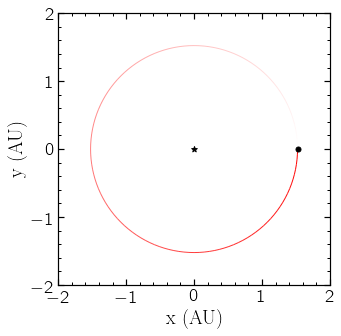

In [16]:
sim = start_new_sim(1) # this starts a new simulation with a star that is 1 solar mass

# adding Mars-like planet!
# Mars is ~1.5AU from the sun
sim.add(m=mass_Mars/mass_Sun, a=a_Mars)
sim.move_to_com()

fig, ax = rebound.OrbitPlot(sim, unitlabel="(AU)", color=True)
ax.set_xlim(-2,2)
ax.set_ylim(-2,2) # notice that we changed the x and y axis limits!!
plt.show()

Hmm... this looks just like the plots we made above. Now let's see how different parameters change the shape of the orbit! 

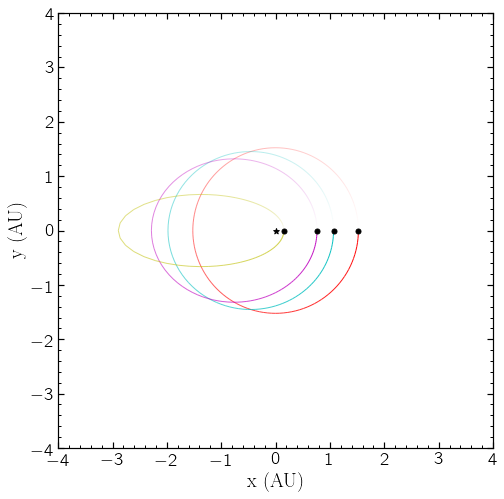

In [17]:
sim = start_new_sim(1) # this starts a new simulation with a star that is 1 solar mass

# adding Mars-like planet!
# Mars is ~1.5AU from the sun
sim.add(m=mass_Mars/mass_Sun, a=a_Mars, e = 0)
sim.add(m=mass_Mars/mass_Sun, a=a_Mars, e = 0.3)
sim.add(m=mass_Mars/mass_Sun, a=a_Mars, e = 0.5)
sim.add(m=mass_Mars/mass_Sun, a=a_Mars, e = 0.9)
sim.move_to_com()

fig, ax = rebound.OrbitPlot(sim, figsize=(8,8),  unitlabel="(AU)", color=True)
ax.set_xlim(-4,4)
ax.set_ylim(-4,4) # notice that we changed the x and y axis limits!!
plt.show()

# what parameter did I change here?

Okay, so now we know that changing the eccentricity changes the shape of the orbit a LOT! Cool. What about the Argument of Periapsis?


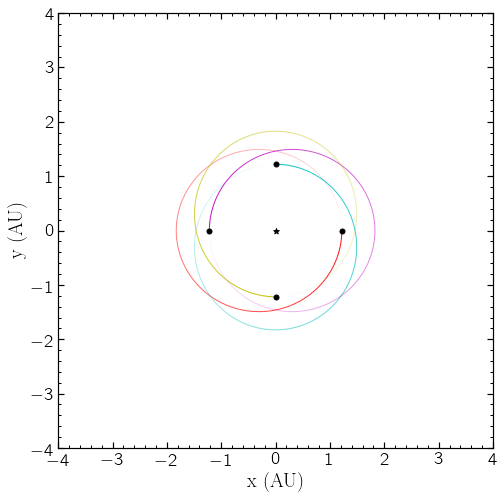

In [18]:
sim = start_new_sim(1) # this starts a new simulation with a star that is 1 solar mass

# adding Mars-like planet!
# Mars is ~1.5AU from the sun
sim.add(m=mass_Mars/mass_Sun, a=a_Mars, e = 0.2, omega = radians(0))
sim.add(m=mass_Mars/mass_Sun, a=a_Mars, e = 0.2, omega = radians(90))
sim.add(m=mass_Mars/mass_Sun, a=a_Mars, e = 0.2, omega = radians(180))
sim.add(m=mass_Mars/mass_Sun, a=a_Mars, e = 0.2, omega = radians(270))
sim.move_to_com()

fig, ax = rebound.OrbitPlot(sim, figsize=(8,8),  unitlabel="(AU)", color=True)
ax.set_xlim(-4,4)
ax.set_ylim(-4,4) # notice that we changed the x and y axis limits!!
plt.show()

# what parameter did I change here?

Very. Cool. 

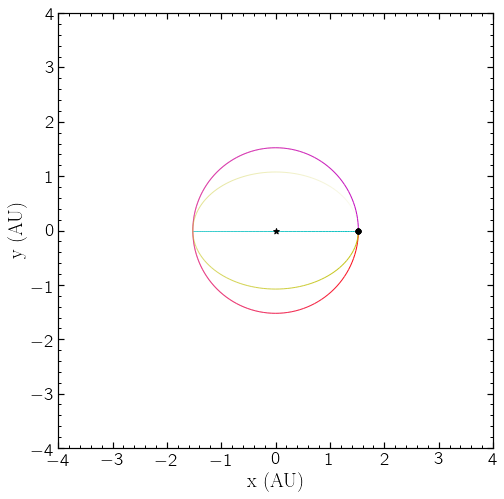

In [19]:
sim = start_new_sim(1) # this starts a new simulation with a star that is 1 solar mass

# adding Mars-like planet!
# Mars is ~1.5AU from the sun
sim.add(m=mass_Mars/mass_Sun, a=a_Mars, inc = 0)
sim.add(m=mass_Mars/mass_Sun, a=a_Mars, inc = radians(90))
sim.add(m=mass_Mars/mass_Sun, a=a_Mars, inc = radians(180))
sim.add(m=mass_Mars/mass_Sun, a=a_Mars, inc = radians(45))
sim.move_to_com()

fig, ax = rebound.OrbitPlot(sim, figsize=(8,8),  unitlabel="(AU)", color=True)
ax.set_xlim(-4,4)
ax.set_ylim(-4,4) # notice that we changed the x and y axis limits!!
plt.show()


Wait.... what happened to this blue line? <font color='cornflowerblue'>**Can anyone explain what happened to this planet's orbit?**</font> 
<br/><br/>
<br/><br/>

<br/><br/>
<br/><br/>


We can also view our system in an interactive widget. If you click and drag in the widget, you can adjust your view of the system.

In [20]:
# The function below launches the widget. size is the displayed size of the widget in pixels,
# while scale sets the volume of space depicted
sim.getWidget(scale=3,size=(500,500)) 



Widget(N=5, count=2, height=500.0, orbit_data=b'\xb3W\x03\xb6\x00\x00\x00\x00\x00\x00\x00\x00\xaa\xf1\xc2?\x86…

Let's integrate our planet's orbit forward in time. We can also use the interactive widget to watch our orbit as it evolves. We've condensed some of the code down for you into a function called ```integrate_with_widget```, which takes as arguments a simulation, a final time, and the number of frames to show as it is integrated up to the final time.

In [22]:
t_final = 5 # Length of simulation in years
N_frames = 200 # Number of frames in the animation

# Start new simulation - you only get 1 widget per simulation, so if you want a new widget, you need a new simulation
sim = start_new_sim(1.) # We call the definition, and we must pass the required elements
sim.add(m=3e-6, a=2., e=0.8, inc=radians(20.), omega=radians(45.), Omega=radians(293.), f=radians(45.), hash='Planet')
sim.move_to_com()

# And now integrate!
integrate_with_widget(sim, t_final, N_frames, 3)

Widget(N=2, count=2, height=500.0, orbit_data=b'p*\xa0\xb5\x01\xf9\x07\xb5\xecQ\xfd\xb4\x00\x00\x00@\xcd\xccL?…

<font color='cornflowerblue' size=4> **Try it yourself:** </font>

Copy everything in the cell above. This time, set the eccentricity to 0, and all the other values to zero as well. Run it to make sure it works. Then, add a *SECOND* planet, and change just one of the values to see how the orbit changes!

In [23]:
# Code here!



<font color='cornflowerblue' size=5>**Making Animations and Gifs!**</font>

In the tools.ipynb notebook, I created functions that would add each of the planets to a simulation! You can use these functions by typing: `addEarth()` or `addJupiter()` etc. There are additional functions, `addInnerPlanets()` to add Mercury, Venus, Earth, and Mars, and `addOuterPlanets()` for Jupiter, Saturn, Uranus, and Neptune. Pluto can be added with `addPluto()`. 

In [24]:
t_final = 50 # Length of simulation in years
N_frames = 200 # Number of frames in the animation

# Start new simulation - you only get 1 widget per simulation, so if you want a new widget, you need a new simulation
sim = start_new_sim(1.) # We call the definition, and we must pass the required elements
addOuterPlanets(sim) # this function adds Jupiter, Saturn, Uranus, and Neptune!
addPluto(sim)
sim.move_to_com()


# And now integrate!
integrate_with_widget(sim, t_final, N_frames, 22) # the 22 stands for the scale used. Increase this number if you want to zoom out!

Widget(N=6, count=2, height=500.0, orbit_data=b"M\x8d\x0e\xbb\xecu\xf9;\xc7\xe4\xac\xb7\xcc\x7f\xa6@['H=^z\x89…

This is a good example of an inclined orbit! Maybe you can see one example for why Pluto doesn't quite fit in the same category as the rest of the planets?

<font color='cornflowerblue'>**Can you tell if Pluto could ever collide with Neptune?**</font>
<br><br>
<br><br>
<br><br>
<br><br>

<font size=4 color='cornflowerblue'> **How do these simulations work?** </font>

This simulation takes small steps forward in time. At each step, the integrator will use the laws of gravity to estimate how the positions and velocities of **every** body in the simulation change. At the next step, it will build from the positions and velocities of the star and planets calculated in the previous step.

To mimic this behavior ourselves in order to create an animation (or video), the cell below uses a `for` loop to incrementally evolve our simulation forward in time. We achieve this by specifying a time step (`dt`) and the number of steps in our loop (`N_steps`). At each step, we add `dt` to the simulation's current time and "integrate" or evolve to this new time. Remember that `sim.integrate` takes the end time, which we have assigned to the variable `new_time`. We also generate an animation frame at each step, which will then be stitched together into an animation similar to the widget above. 

Note that we name our animation `ani` - the word `animation` belongs to a package we imported, so we can't use it as a variable name.

In [32]:
%%capture 
# This cell produces a lot of unnecessary output, so we'll capture that output instead of printing it out.
# The next code cell will actually display the animation.

dt = 0.1 # Let's integrate a tenth of a year each step
N_steps = 200 # Let's integrate it forward for 20 steps, so 20*0.1 = 2 years

# Start a fresh simulation
sim = start_new_sim(1.) 
sim.add(m=mass_Jupiter/mass_Sun, a=a_Jupiter)
sim.move_to_com()

# We need to create a figure (fig) and axes (ax) for the animation
fig,ax = plt.subplots(1,1,figsize=(5,5))

# The animation is created from a list of frames
frames = []

for i in range(N_steps):
    
    new_time = sim.t+dt # The time we want to integrate to
    sim.integrate(new_time) # And integrate!
    
    frames.append(make_rebound_frame(ax,sim)) # Add the new frame to the list for animation
       
# Create the animation
ani = animation.ArtistAnimation(fig, frames)

In [33]:
ani

<font color='cornflowerblue' size=4> **Use the animation to figure out Jupiter's Orbital Period**</font>

Since the only information that is used in constructing this simulation is info about the orbit, the amount of time it takes for Jupiter to orbit the sun is only related to it's orbital parameters! In particular, the orbital period is closely-related to the distance from the sun. Can you use the animation we made to determine Jupiter's orbital period?<br><br><br><br>

<font color='cornflowerblue' size=4>**Now you!**</font>

Make an animation with 20 frames again, but use the orbits of the outer planets and Pluto. *Be warned: the more planets you add, the longer the integration will take! It will take about 30 seconds for this to run.* 

Take the following steps to complete this: 
1. change the time steps to be one year long, since the outer planets do not move very far in one year.
2. start a new simulation, with the Sun, Jupiter, Saturn, Uranus, Neptune, and Pluto.
3. Run for ~30 seconds, then run the cell that shows the animation


<font color='cornflowerblue' size=5>**Gifs**</font>

Alternatively, we can turn this animation into a gif that we can use to show our friends or family! We want to go through a series of time steps, make a plot for each time step, and save a picture at each step. 

In [34]:
%%capture
# this for loop will print out the image that we're saving. if you'd like to see them, uncomment the line above

dt = 1 # Let's go forward a full year each step
N_steps = 100 # Let's integrate it forward for 20 steps, so 20 years

sim = start_new_sim(1) # We call the definition, and we must pass the required elements
addOuterPlanets(sim)
addPluto(sim)

# As before, we have to re-center the simulation before evolving it forward in time
sim.move_to_com()

for i in range(N_steps):
    
    new_time = sim.t+dt # The time we want to integrate to
    sim.integrate(new_time) # And integrate!
    
    rebound.OrbitPlot(sim, unitlabel="(AU)", color=True)
    plt.savefig('figs/step_'+str(i)+'.png')
    

If you go back to the tab with your google drive(or if using Binder, the tab that says 'Home'), you'll see a folder listed that reads 'figs'. If you open that folder, you'll see a list of a bunch of figures! If you open one, you'll see an image of an orbit we simulated. Now, we have to stitch all of those images into a gif! 

We can do that by running the cell below, which goes through each image and stitches it to the previous one, and then exports the movie as a gif!

In [36]:
import imageio # This is the package we need for converting images to gifs
images = []
filenames = ['figs/step_'+str(i)+'.png' for i in range(N_steps)]
for filename in filenames:
    images.append(imageio.imread(filename))
imageio.mimsave('movie.gif', images)

You can find this 'movie.gif' file in the other table where you saw the single image. You can download this image by: (Binder:) clicking on the check box, and going to the top and pressing download (Google Docs:) Right click on the file and click download. Let me know if you have trouble with this! 

<font color='cornflowerblue'>**Now, you can make whatever gifs you want!**</font> You can simulate the inner planets, the outer planets, all the planets, include Pluto, include any asteroids or comets you want (remember you can use the automated feature that Rebound has to look up all these orbital parameters easily!)

You could also try: 
- making gifs of a bunch of planets that are all the same, except differ by one orbital parameter
- finding an example of some orbits that result in a planet getting kicked out of it's planetary system
- seeing what happens when you increase or decrease the mass of the planets


<sup> Notebook written by [Katie Chamberlain](katiechambe.github.io) in 2019 and 2020. Adapted by [Logan Pearce](logan-pearce.github.io) in 2021</sup>  